# Importation

In [1]:
import os  # Operating system module for file and directory management
import shutil  # For high-level file operations like copying and removing files
import random  # Random module for generating random numbers
import numpy as np  # NumPy for numerical computations
import pandas as pd  # Pandas for data manipulation and analysis

# Import libraries for image processing and visualization
import cv2  # OpenCV for image processing and computer vision tasks
import matplotlib.pyplot as plt  # Matplotlib for static and interactive visualizations
import seaborn as sns  # Seaborn for advanced statistical data visualization
from PIL import Image, ImageEnhance, ImageFilter, ImageStat  # Python Imaging Library for handling and modifying images
from IPython.display import display  # Display objects in Jupyter notebooks

# Import TensorFlow and Keras for deep learning
import tensorflow as tf  # Core TensorFlow library for machine learning
from tensorflow.keras.preprocessing import image as tf_image  # Image preprocessing tools from Keras
from tensorflow.keras import layers, models, applications  # Keras API for model and layer definitions
from tensorflow.keras.utils import to_categorical  # Converts categorical labels to one-hot encoding
from tensorflow.keras.models import Sequential  # Sequential model for building CNN architectures
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization,LSTM  # Layers for CNN architecture
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau  # Callbacks for training optimization

# Import Scikit-Learn for machine learning models and evaluation
from sklearn.model_selection import train_test_split  # Splitting dataset into training and testing subsets
from sklearn.preprocessing import LabelEncoder  # Encoding categorical labels into numeric format
from sklearn.ensemble import RandomForestClassifier  # Random Forest classifier for machine learning tasks
from sklearn.utils import shuffle  # Shuffling datasets
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix  # Metrics for model evaluation

# Import tqdm for progress bar visualization in loops
from tqdm import tqdm  # Provides a progress bar to monitor execution time

# Read Basic Dataset

In [2]:
# Define the base folder containing the dataset
base_folder = r"D:\1\archive\dataset pro\collection" 

# Prepare a list to store image data and labels
data = []

# Load images and corresponding labels
for disease_folder in os.listdir(base_folder):  # Iterate over each folder (representing a disease category)
    disease_path = os.path.join(base_folder, disease_folder)  # Get the full path of the disease folder
    if os.path.isdir(disease_path):  # Check if it's a directory
        for img_file in os.listdir(disease_path):  # Iterate over all files in the disease folder
            img_path = os.path.join(disease_path, img_file)  # Get the full path of the image file
            # Check if the file is an image (by extension)
            if img_file.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
                try:
                    # Open the image, convert to RGB, and resize to a fixed size (64x64 for uniformity)
                    img = Image.open(img_path).convert("RGB").resize((64, 64))  # Resize helps with faster processing
                    
                    # Append the image data and its corresponding label to the list
                    data.append({"image": img, "label": disease_folder})
                except Exception as e:
                    # Handle any exceptions (e.g., corrupted files) and log the error
                    print(f"Error loading image {img_file}: {e}")

# Convert the collected data into a Pandas DataFrame for easier manipulation and analysis
df = pd.DataFrame(data)

# Display the resulting DataFrame
df


,image,label
0,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal
1,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal
2,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal
3,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal
4,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal
...,...,...
527,<PIL.Image.Image image mode=RGB size=64x64 at ...,Pustular
528,<PIL.Image.Image image mode=RGB size=64x64 at ...,Pustular
529,<PIL.Image.Image image mode=RGB size=64x64 at ...,Pustular
530,<PIL.Image.Image image mode=RGB size=64x64 at ...,Pustular


# Data Augmentation

In [3]:
# Define augmentation function
def augment_image(image):
    """Apply random transformations to augment an image."""
    transformations = [
        lambda x: x.rotate(random.randint(-30, 30)),  # Rotate
        lambda x: x.transpose(Image.FLIP_LEFT_RIGHT),  # Flip horizontally
        lambda x: x.transpose(Image.FLIP_TOP_BOTTOM),  # Flip vertically
        lambda x: ImageEnhance.Brightness(x).enhance(random.uniform(0.8, 1.2)),  # Adjust brightness
        lambda x: ImageEnhance.Color(x).enhance(random.uniform(0.8, 1.2)),  # Adjust color
        lambda x: ImageEnhance.Contrast(x).enhance(random.uniform(0.8, 1.2)),  # Adjust contrast
        lambda x: ImageEnhance.Sharpness(x).enhance(random.uniform(0.8, 1.2))  # Adjust sharpness
    ]
    
    augmented = image
    for t in random.sample(transformations, k=random.randint(1, len(transformations))):  # Apply random transformations
        augmented = t(augmented)
    return augmented

# Balance dataset to exactly 500 images per class
balanced_data = []
target_count = 500  # Desired number of images per class

for label in df['label'].unique():
    class_samples = df[df['label'] == label]
    images = class_samples['image'].tolist()
    current_count = len(images)
    
    # If the class has more than 500 images, randomly sample 500
    if current_count > target_count:
        selected_samples = random.sample(images, target_count)
        balanced_data.extend([{"image": img, "label": label} for img in selected_samples])
    
    # If the class has fewer than 500 images, augment until 500
    elif current_count < target_count:
        augmented_images = []
        while len(images) + len(augmented_images) < target_count:
            img = random.choice(images)
            augmented_images.append(augment_image(img))
        # Add both original and augmented images to the balanced dataset
        balanced_data.extend([{"image": img, "label": label} for img in images])
        balanced_data.extend([{"image": img, "label": label} for img in augmented_images])
    
    # If the class already has exactly 500 images, add them as is
    else:
        balanced_data.extend([{"image": img, "label": label} for img in images])

# Shuffle the final dataset
final_df = pd.DataFrame(balanced_data)
final_df = shuffle(final_df).reset_index(drop=True)

# Save augmented images to a folder for verification 
output_folder = r"D:\1\archive\balanced_dataset"
os.makedirs(output_folder, exist_ok=True)

for idx, row in final_df.iterrows():
    img, label = row['image'], row['label']
    class_folder = os.path.join(output_folder, label)
    os.makedirs(class_folder, exist_ok=True)
    save_path = os.path.join(class_folder, f"{label}_{idx}.png")
    img.save(save_path)

# Display final class distribution
print("Class distribution after balancing:")
print(final_df['label'].value_counts())

Class distribution after balancing:
label
Pustular        500
Guttate         500
Plaque          500
Erythromelal    500
Inverse         500
Normal          500
Name: count, dtype: int64


# Plot Data 

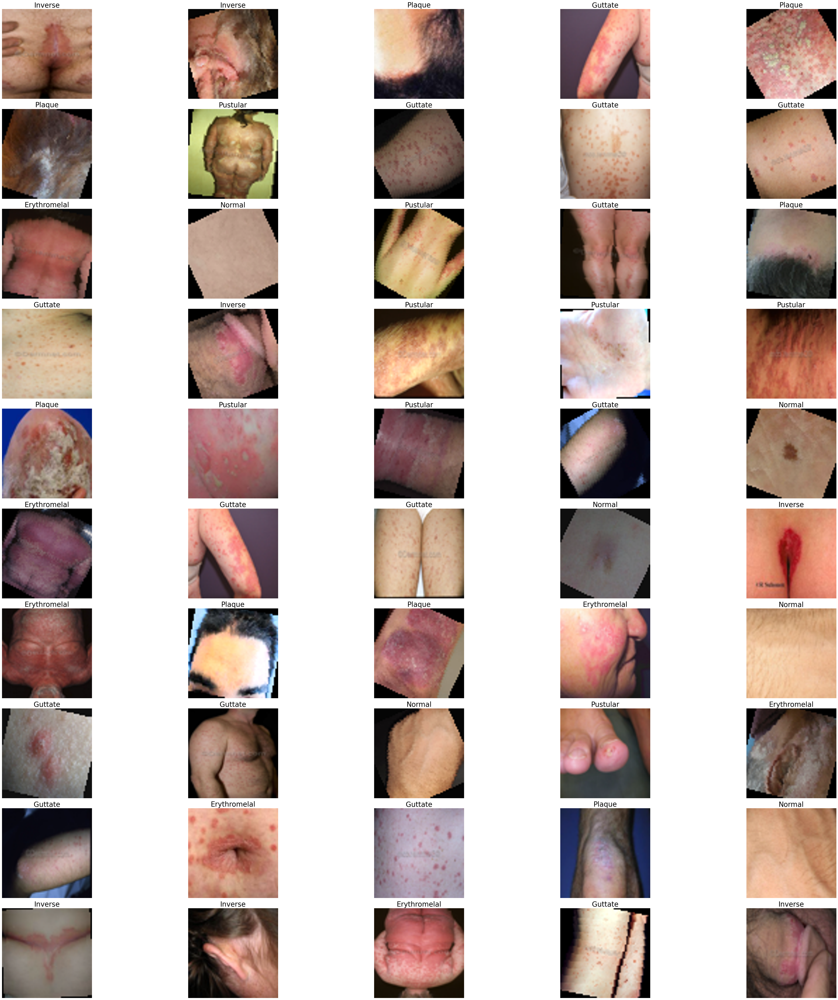

In [4]:
# Set the figure size for the entire subplot grid
plt.figure(figsize=(50, 50))

# Loop over a randomly selected subset of 50 samples from the DataFrame
for n, i in enumerate(np.random.randint(0, len(final_df), 50)):
    # Create subplots in a 10x5 grid
    plt.subplot(10, 5, n+1)
    
    # Get the PIL image at index 'i' from the DataFrame
    img = final_df.iloc[i]['image']
    
    # Resize the image for consistency (if needed)
    img_resized = img.resize((224, 224))
    
    # Display the image in the subplot
    plt.imshow(img_resized)
    
    # Turn off axis labels
    plt.axis('off')
    
    # Set the title of the subplot with the corresponding label from the DataFrame
    plt.title(final_df.iloc[i]['label'], fontsize=25)

# Show the plot
plt.tight_layout()
plt.show()


# Enhance Quality 

In [5]:
def enhance_image_quality(image):
    """Enhance image quality by reducing noise, improving sharpness, contrast, and brightness."""
    # Resize to a fixed size (64x64) using LANCZOS resampling
    image = image.resize((64, 64), Image.Resampling.LANCZOS)
    
    # Noise reduction using a median filter
    image = image.filter(ImageFilter.MedianFilter(size=3))
    
    # Sharpen image
    image = image.filter(ImageFilter.UnsharpMask(radius=2, percent=150, threshold=3))
    
    # Enhance brightness
    enhancer_brightness = ImageEnhance.Brightness(image)
    image = enhancer_brightness.enhance(1.2)  # Increase brightness
    
    # Enhance contrast
    enhancer_contrast = ImageEnhance.Contrast(image)
    image = enhancer_contrast.enhance(1.3)  # Increase contrast
    
    # Enhance color
    enhancer_color = ImageEnhance.Color(image)
    image = enhancer_color.enhance(1.2)  # Boost colors
    
    return image

# Define the base folder containing the dataset
base_folder = r"D:\1\archive\balanced_dataset"  

# Prepare a list to store processed image data and labels
enhanced_data = []

# Iterate through the dataset
for disease_folder in os.listdir(base_folder):  # Iterate over each folder (representing a disease category)
    disease_path = os.path.join(base_folder, disease_folder)  # Get the full path of the disease folder
    if os.path.isdir(disease_path):  # Check if it's a directory
        for img_file in os.listdir(disease_path):  # Iterate over all files in the disease folder
            img_path = os.path.join(disease_path, img_file)  # Get the full path of the image file
            # Check if the file is an image (by extension)
            if img_file.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
                try:
                    # Open the image
                    img = Image.open(img_path)
                    
                    # Enhance the image quality
                    enhanced_img = enhance_image_quality(img)
                    
                    # Append the enhanced image and its corresponding label
                    enhanced_data.append({"image": enhanced_img, "label": disease_folder})
                except Exception as e:
                    # Handle any exceptions (e.g., corrupted files) and log the error
                    print(f"Error processing image {img_file}: {e}")

# Convert the collected enhanced data into a Pandas DataFrame
df_enhanced = pd.DataFrame(enhanced_data)

# Display the resulting DataFrame with enhanced images
df_enhanced.head()  # Show the first few rows


,image,label
0,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal
1,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal
2,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal
3,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal
4,<PIL.Image.Image image mode=RGB size=64x64 at ...,Erythromelal


# Plot Data

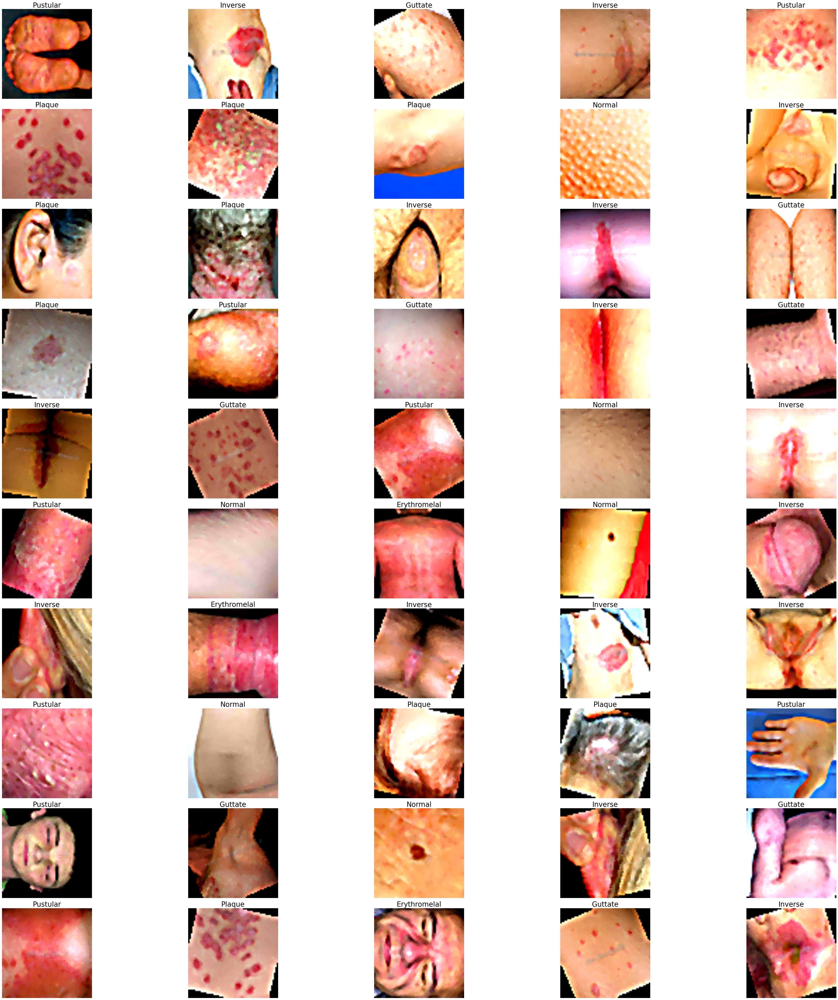

In [6]:
# Set the figure size for the entire subplot grid
plt.figure(figsize=(50, 50))

# Loop over a randomly selected subset of 50 samples from the DataFrame
for n, i in enumerate(np.random.randint(0, len(df_enhanced), 50)):
    # Create subplots in a 10x5 grid
    plt.subplot(10, 5, n+1)
    
    # Get the PIL image at index 'i' from the DataFrame
    img = df_enhanced.iloc[i]['image']
    
    # Resize the image for consistency (if needed)
    img_resized = img.resize((224, 224))
    
    # Display the image in the subplot
    plt.imshow(img_resized)
    
    # Turn off axis labels
    plt.axis('off')
    
    # Set the title of the subplot with the corresponding label from the DataFrame
    plt.title(df_enhanced.iloc[i]['label'], fontsize=25)

# Show the plot
plt.tight_layout()
plt.show()


# Label Encoder

In [7]:
# Assuming you already have the df_enhanced DataFrame with images and labels
labels = df_enhanced['label'].values

# Label Encoding
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)

# One-Hot Encoding the labels for multi-class classification
labels_one_hot = to_categorical(labels_encoded)

# Display the encoded labels
print(labels_one_hot)

[[1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0.]
 ...
 [0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 1.]]


# Split Data 

In [8]:
# Extracting the images and labels from the DataFrame
# For images, convert each PIL Image to a NumPy array
images = np.array([np.array(img) for img in df_enhanced['image']])

# Extract the labels
labels = df_enhanced['label'].values

# Label Encoding
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)

# One-Hot Encoding the labels for multi-class classification
labels_one_hot = to_categorical(labels_encoded)

# Display the encoded labels
print(labels_one_hot)

# Split the data into training and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(images, labels_one_hot, test_size=0.2, random_state=42)

# Normalize the images (scale pixel values to range [0, 1])
X_train_cnn = X_train / 255.0
X_test_cnn = X_test / 255.0

# Ensure the images have the correct shape (height, width, channels) for CNN
X_train_cnn = X_train_cnn.reshape(-1, 64, 64, 3)
X_test_cnn = X_test_cnn.reshape(-1, 64, 64, 3)

# Ensure the images have the correct shape (time_steps, features) for LSTM (flattened for LSTM)
X_train_lstm = X_train.reshape(X_train.shape[0], 64 * 64 * 3)
X_test_lstm = X_test.reshape(X_test.shape[0], 64 * 64 * 3)

# Normalize the data for LSTM
X_train_lstm = X_train_lstm / 255.0
X_test_lstm = X_test_lstm / 255.0

print(f"CNN input shape: {X_train_cnn.shape}")
print(f"LSTM input shape: {X_train_lstm.shape}")


[[1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0.]
 ...
 [0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 1.]]
CNN input shape: (7467, 64, 64, 3)
LSTM input shape: (7467, 12288)


# CNN Model 20 Epoch

In [9]:
# Build CNN Model
cnn_model = Sequential()

# First convolutional layer
cnn_model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 3)))
cnn_model.add(MaxPooling2D((2, 2)))

# Second convolutional layer
cnn_model.add(Conv2D(64, (3, 3), activation='relu'))
cnn_model.add(MaxPooling2D((2, 2)))

# Flatten the output of convolutional layers
cnn_model.add(Flatten())

# Fully connected layer
cnn_model.add(Dense(128, activation='relu'))

# Dropout layer for regularization
cnn_model.add(Dropout(0.5))

# Output layer (softmax for multi-class classification)
cnn_model.add(Dense(len(label_encoder.classes_), activation='softmax'))

# Compile the CNN model
cnn_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the CNN model
cnn_model.fit(X_train_cnn, y_train, validation_split=0.2, epochs=20, batch_size=32)

# Evaluate the CNN model on the test set
cnn_test_loss, cnn_test_accuracy = cnn_model.evaluate(X_test_cnn, y_test)
print(f"CNN Test Accuracy: {cnn_test_accuracy}")


C:\Users\asus\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 54s 267ms/step - accuracy: 0.3450 - loss: 1.5941 - val_accuracy: 0.5689 - val_loss: 1.1283
Epoch 2/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 47s 250ms/step - accuracy: 0.5617 - loss: 1.1653 - val_accuracy: 0.6740 - val_loss: 0.9363
Epoch 3/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 50s 268ms/step - accuracy: 0.6810 - loss: 0.8706 - val_accuracy: 0.7369 - val_loss: 0.7339
Epoch 4/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 78s 241ms/step - accuracy: 0.7141 - loss: 0.7481 - val_accuracy: 0.7871 - val_loss: 0.6368
Epoch 5/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 46s 246ms/step - accuracy: 0.7828 - loss: 0.6007 - val_accuracy: 0.8340 - val_loss: 0.5223
Epoch 6/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 49s 263ms/step - accuracy: 0.8123 - loss: 0.5004 - val_accuracy: 0.8340 - val_loss: 0.4954
Epoch 7/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 47s 253ms/step - accuracy: 0.8460 - loss: 0.4281 - val_accuracy: 0.8527 - val_loss: 0.4543
Epoch 8/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 49s 262ms/step - accuracy: 0.8665 - loss: 0

# CNN confusion matrix

59/59 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step


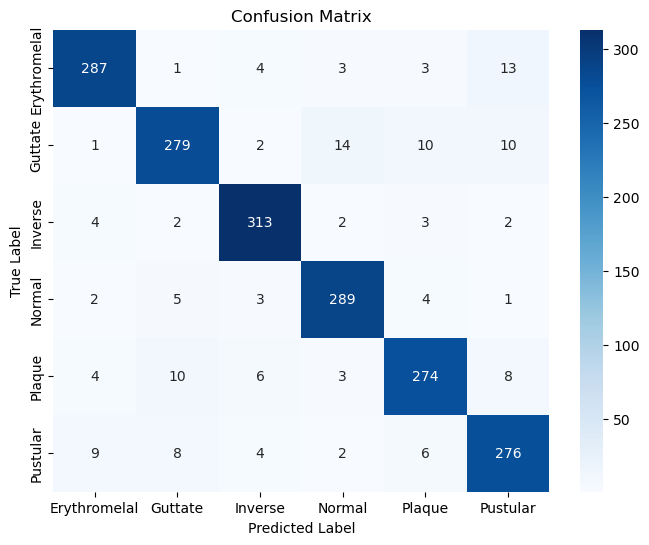

              precision    recall  f1-score   support

Erythromelal       0.93      0.92      0.93       311
     Guttate       0.91      0.88      0.90       316
     Inverse       0.94      0.96      0.95       326
      Normal       0.92      0.95      0.94       304
      Plaque       0.91      0.90      0.91       305
    Pustular       0.89      0.90      0.90       305

    accuracy                           0.92      1867
   macro avg       0.92      0.92      0.92      1867
weighted avg       0.92      0.92      0.92      1867



In [10]:
# Get model predictions
y_pred_probs = cnn_model.predict(X_test_cnn)  # Get probability outputs
y_pred_classes = np.argmax(y_pred_probs, axis=1)  # Convert to class labels
y_true_classes = np.argmax(y_test, axis=1)  # Convert one-hot encoded labels to class labels

# Compute confusion matrix
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# Print detailed classification report
print(classification_report(y_true_classes, y_pred_classes, target_names=label_encoder.classes_))


# CNN with 50 Epoch and early stop

In [11]:
# Build Optimized CNN Model
cnn_model_es = Sequential()

# Block 1
cnn_model_es.add(Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 3)))
cnn_model_es.add(BatchNormalization())
cnn_model_es.add(MaxPooling2D((2, 2)))

# Block 2
cnn_model_es.add(Conv2D(64, (3, 3), activation='relu'))
cnn_model_es.add(BatchNormalization())
cnn_model_es.add(MaxPooling2D((2, 2)))

# Block 3 (Added for better feature extraction)
cnn_model_es.add(Conv2D(128, (3, 3), activation='relu'))
cnn_model_es.add(BatchNormalization())
cnn_model_es.add(MaxPooling2D((2, 2)))

# Block 4 (Extra layer for deeper learning)
cnn_model_es.add(Conv2D(256, (3, 3), activation='relu'))
cnn_model_es.add(BatchNormalization())
cnn_model_es.add(MaxPooling2D((2, 2)))

# Flatten
cnn_model_es.add(Flatten())

# Fully Connected Layer
cnn_model_es.add(Dense(256, activation='relu'))
cnn_model_es.add(Dropout(0.3))  # Reduced dropout to keep more information

# Output Layer (Softmax for multi-class classification)
cnn_model_es.add(Dense(len(label_encoder.classes_), activation='softmax'))

# Compile CNN model
cnn_model_es.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1)

# Train CNN model
cnn_model_es.fit(X_train_cnn, y_train, validation_split=0.2, epochs=50, batch_size=32, callbacks=[early_stopping, lr_scheduler])

# Evaluate CNN model on test set
cnn_test_loss, cnn_test_accuracy = cnn_model_es.evaluate(X_test_cnn, y_test)
print(f"CNN Test Accuracy: {cnn_test_accuracy}")


C:\Users\asus\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 102s 508ms/step - accuracy: 0.4531 - loss: 1.7277 - val_accuracy: 0.1700 - val_loss: 5.3282 - learning_rate: 0.0010
Epoch 2/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 92s 492ms/step - accuracy: 0.7253 - loss: 0.7686 - val_accuracy: 0.2791 - val_loss: 3.1076 - learning_rate: 0.0010
Epoch 3/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 90s 483ms/step - accuracy: 0.8200 - loss: 0.5201 - val_accuracy: 0.8260 - val_loss: 0.5153 - learning_rate: 0.0010
Epoch 4/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 140s 473ms/step - accuracy: 0.8968 - loss: 0.3090 - val_accuracy: 0.7898 - val_loss: 0.5984 - learning_rate: 0.0010
Epoch 5/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 92s 492ms/step - accuracy: 0.9135 - loss: 0.2573 - val_accuracy: 0.9016 - val_loss: 0.3072 - learning_rate: 0.0010
Epoch 6/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 142s 490ms/step - accuracy: 0.9444 - loss: 0.1622 - val_accuracy: 0.8922 - val_loss: 0.3414 - learning_rate: 0.0010
Epoch 7/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 142s 487ms/step - accuracy:

# Show confusion matrix

59/59 ━━━━━━━━━━━━━━━━━━━━ 7s 108ms/step


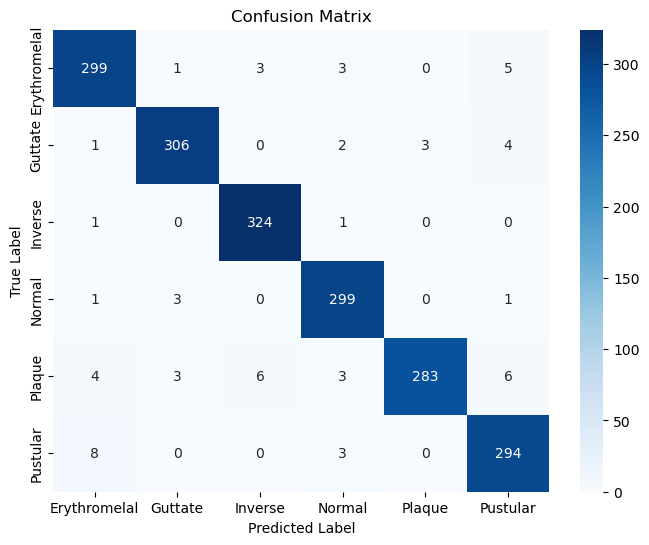

              precision    recall  f1-score   support

Erythromelal       0.95      0.96      0.96       311
     Guttate       0.98      0.97      0.97       316
     Inverse       0.97      0.99      0.98       326
      Normal       0.96      0.98      0.97       304
      Plaque       0.99      0.93      0.96       305
    Pustular       0.95      0.96      0.96       305

    accuracy                           0.97      1867
   macro avg       0.97      0.97      0.97      1867
weighted avg       0.97      0.97      0.97      1867



In [12]:
# Get model predictions
y_pred_probs = cnn_model_es.predict(X_test_cnn)  # Get probability outputs
y_pred_classes = np.argmax(y_pred_probs, axis=1)  # Convert to class labels
y_true_classes = np.argmax(y_test, axis=1)  # Convert one-hot encoded labels to class labels

# Compute confusion matrix
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# Print detailed classification report
print(classification_report(y_true_classes, y_pred_classes, target_names=label_encoder.classes_))


# LSTM with early stop

In [13]:
# Reshape images into sequences for LSTM (time_steps = 64, features = 64 * 3)
X_train_lstm = X_train.reshape(X_train.shape[0], 64, 64 * 3) / 255.0
X_test_lstm = X_test.reshape(X_test.shape[0], 64, 64 * 3) / 255.0

# Build LSTM Model
lstm_model = Sequential()

# First LSTM Layer
lstm_model.add(LSTM(128, return_sequences=True, input_shape=(64, 64 * 3)))
lstm_model.add(BatchNormalization())
lstm_model.add(Dropout(0.3))

# Second LSTM Layer
lstm_model.add(LSTM(256, return_sequences=True))
lstm_model.add(BatchNormalization())

# Third LSTM Layer
lstm_model.add(LSTM(128, return_sequences=False))  # Last layer returns a single vector
lstm_model.add(BatchNormalization())

# Fully Connected Layer
lstm_model.add(Dense(256, activation='relu'))
lstm_model.add(Dropout(0.3))

# Output Layer (Softmax for multi-class classification)
lstm_model.add(Dense(len(label_encoder.classes_), activation='softmax'))

# Compile Model
lstm_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1)

# Train Model
lstm_model.fit(X_train_lstm, y_train, validation_split=0.2, epochs=50, batch_size=32, callbacks=[early_stopping, lr_scheduler])

# Evaluate Model
lstm_test_loss, lstm_test_accuracy = lstm_model.evaluate(X_test_lstm, y_test)
print(f"LSTM Test Accuracy: {lstm_test_accuracy}")


C:\Users\asus\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 142s 686ms/step - accuracy: 0.3191 - loss: 1.7414 - val_accuracy: 0.2965 - val_loss: 1.6205 - learning_rate: 0.0010
Epoch 2/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 135s 724ms/step - accuracy: 0.4273 - loss: 1.4452 - val_accuracy: 0.3762 - val_loss: 1.6607 - learning_rate: 0.0010
Epoch 3/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 124s 664ms/step - accuracy: 0.4762 - loss: 1.3651 - val_accuracy: 0.4471 - val_loss: 1.4101 - learning_rate: 0.0010
Epoch 4/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 127s 677ms/step - accuracy: 0.5099 - loss: 1.2701 - val_accuracy: 0.4418 - val_loss: 1.4332 - learning_rate: 0.0010
Epoch 5/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 129s 690ms/step - accuracy: 0.5771 - loss: 1.1225 - val_accuracy: 0.4886 - val_loss: 1.5307 - learning_rate: 0.0010
Epoch 6/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 130s 697ms/step - accuracy: 0.6271 - loss: 1.0067 - val_accuracy: 0.6158 - val_loss: 1.0298 - learning_rate: 0.0010
Epoch 7/50
187/187 ━━━━━━━━━━━━━━━━━━━━ 138s 675ms/step - accura

59/59 ━━━━━━━━━━━━━━━━━━━━ 9s 142ms/step


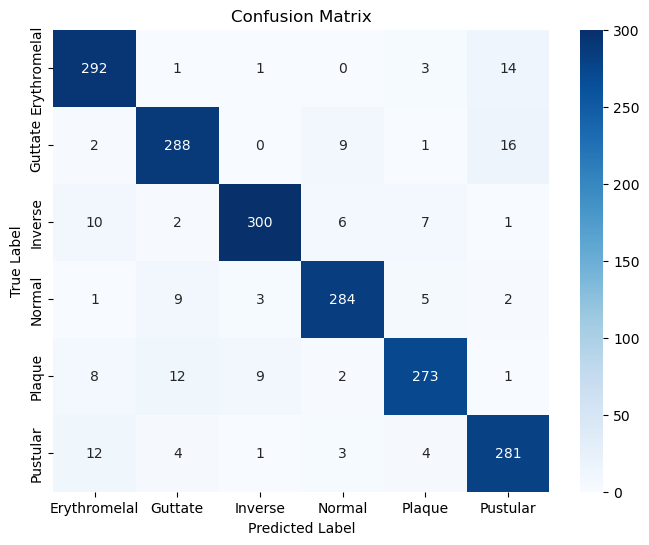

              precision    recall  f1-score   support

Erythromelal       0.90      0.94      0.92       311
     Guttate       0.91      0.91      0.91       316
     Inverse       0.96      0.92      0.94       326
      Normal       0.93      0.93      0.93       304
      Plaque       0.93      0.90      0.91       305
    Pustular       0.89      0.92      0.91       305

    accuracy                           0.92      1867
   macro avg       0.92      0.92      0.92      1867
weighted avg       0.92      0.92      0.92      1867



In [14]:
# Get model predictions
y_pred_probs = lstm_model.predict(X_test_lstm)  # Get probability outputs
y_pred_classes = np.argmax(y_pred_probs, axis=1)  # Convert to class labels
y_true_classes = np.argmax(y_test, axis=1)  # Convert one-hot encoded labels to class labels

# Compute confusion matrix
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# Print detailed classification report
print(classification_report(y_true_classes, y_pred_classes, target_names=label_encoder.classes_))


# Comparision between models

C:\Users\asus\AppData\Local\Temp\ipykernel_4884\2673475032.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=models, y=accuracies, palette=colors, edgecolor="black", linewidth=1.5)
C:\Users\asus\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


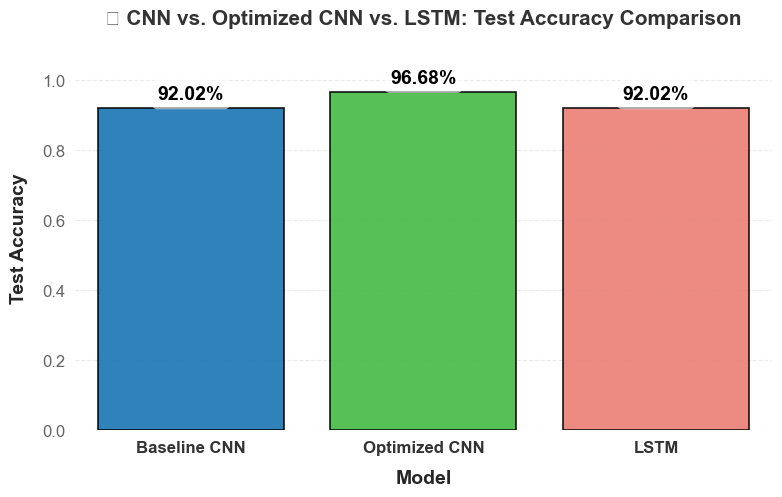

In [33]:
# Extract test accuracy from model evaluation
cnn_test_loss, cnn_test_acc = cnn_model.evaluate(X_test_cnn, y_test, verbose=0)
cnn_es_test_loss, cnn_es_test_acc = cnn_model_es.evaluate(X_test_cnn, y_test, verbose=0)
lstm_test_loss, lstm_test_acc = lstm_model.evaluate(X_test_lstm, y_test, verbose=0)

# Data for bar chart
models = ["Baseline CNN", "Optimized CNN", "LSTM"]
accuracies = [cnn_test_acc, cnn_es_test_acc, lstm_test_acc]

# Set up figure
plt.figure(figsize=(9, 5))
sns.set_style("whitegrid")

# Define vibrant colors
colors = ["#007ACC", "#32CD32", "#FF6F61"]  # Blue (CNN), Green (Optimized CNN), Red (LSTM)

# Create the bar chart
ax = sns.barplot(x=models, y=accuracies, palette=colors, edgecolor="black", linewidth=1.5)

# Add accuracy values on top of bars with glow effect
for i, acc in enumerate(accuracies):
    plt.text(i, acc + 0.025, f"{acc:.2%}", ha='center', fontsize=14, fontweight='bold', color="black",
             bbox=dict(facecolor='white', alpha=0.6, edgecolor='none', boxstyle="round,pad=0.3"))

# Enhancing chart aesthetics
plt.xlabel("Model", fontsize=14, fontweight="bold", labelpad=10)
plt.ylabel("Test Accuracy", fontsize=14, fontweight="bold", labelpad=10)
plt.title("🔥 CNN vs. Optimized CNN vs. LSTM: Test Accuracy Comparison", fontsize=15, fontweight="bold", pad=15, color="#333")

# Customizing the chart
plt.ylim(0, 1.1)  # Extend range slightly for better readability
plt.xticks(fontsize=12, fontweight="bold", color="#333")
plt.yticks(fontsize=12, color="#666")
plt.grid(axis='y', linestyle="--", alpha=0.4)  # Light grid lines for depth
sns.despine(left=True, bottom=True)  # Remove border for a clean look

# Add subtle shadow effect for depth
for bar in ax.patches:
    bar.set_linewidth(1.2)
    bar.set_edgecolor("black")
    bar.set_alpha(0.9)

# Show the plot
plt.show()


# Save Models

In [38]:
# Save all three models in H5 format
cnn_model.save("cnn_model.h5")
cnn_model_es.save("cnn_model_es.h5")
lstm_model.save("lstm_model.h5")

print("✅ All models saved successfully!")


✅ All models saved successfully!


# Testing

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


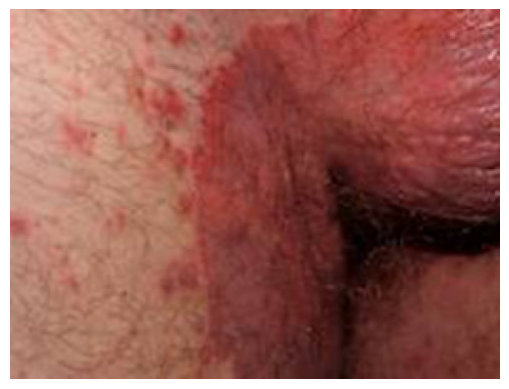

The predicted label for the uploaded image is: Inverse


In [35]:
from tensorflow.keras.preprocessing import image

# Function to preprocess the uploaded image
def preprocess_image(img_path):
    # Open the image file
    img = Image.open(img_path)
    
    # Enhance the image (if you want to use your enhancement function)
    enhanced_img = enhance_image_quality(img)
    
    # Resize the image to the input shape expected by the model (64x64)
    enhanced_img = enhanced_img.resize((64, 64))
    
    # Convert the image to an array
    img_array = image.img_to_array(enhanced_img)
    
    # Normalize the image (assuming your model expects this preprocessing)
    img_array = img_array / 255.0
    
    # Reshape it to include the batch dimension (1, 64, 64, 3)
    img_array = np.expand_dims(img_array, axis=0)
    
    return img_array

# Function to predict the class of the uploaded image
def predict_image_class(img_path):
    # Preprocess the image
    img_array = preprocess_image(img_path)
    
    # Predict the class using the CNN model
    prediction = cnn_model_es.predict(img_array)
    
    # Get the index of the class with the highest probability
    predicted_class_index = np.argmax(prediction)
    
    # Map the class index to the actual label
    predicted_class_label = label_encoder.classes_[predicted_class_index]
    
    # Display the image
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    
    # Return the prediction label
    return predicted_class_label

img_path = "D:\\1\\archive\\dataset pro\\collection\\Inverse\\flexural-psoriasis9-s__ProtectWyJQcm90ZWN0Il0_FocusFillWzI5NCwyMjIsIngiLDFd.jpg"
predicted_label = predict_image_class(img_path)
print(f"The predicted label for the uploaded image is: {predicted_label}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


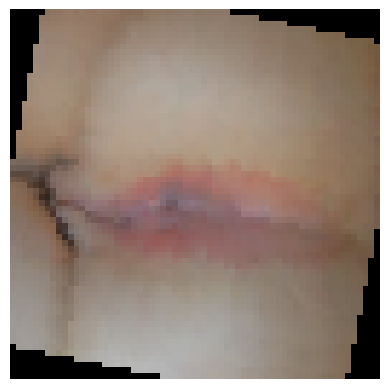

The predicted label for the uploaded image is: Inverse


In [36]:
# Function to preprocess the uploaded image
def preprocess_image(img_path):
    # Open the image file
    img = Image.open(img_path)
    
    # Enhance the image (if you want to use your enhancement function)
    enhanced_img = enhance_image_quality(img)
    
    # Resize the image to the input shape expected by the model (64x64)
    enhanced_img = enhanced_img.resize((64, 64))
    
    # Convert the image to an array
    img_array = image.img_to_array(enhanced_img)
    
    # Normalize the image (assuming your model expects this preprocessing)
    img_array = img_array / 255.0
    
    # Reshape it to include the batch dimension (1, 64, 64, 3)
    img_array = np.expand_dims(img_array, axis=0)
    
    return img_array

# Function to predict the class of the uploaded image
def predict_image_class(img_path):
    # Preprocess the image
    img_array = preprocess_image(img_path)
    
    # Predict the class using the CNN model
    prediction = cnn_model_es.predict(img_array)
    
    # Get the index of the class with the highest probability
    predicted_class_index = np.argmax(prediction)
    
    # Map the class index to the actual label
    predicted_class_label = label_encoder.classes_[predicted_class_index]
    
    # Display the image
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    
    # Return the prediction label
    return predicted_class_label

img_path = "D:\\1\\archive\\balanced_dataset\\Inverse\\Inverse_59.png"
predicted_label = predict_image_class(img_path)
print(f"The predicted label for the uploaded image is: {predicted_label}")

In [ ]:
# Function to preprocess the uploaded image
def preprocess_image(img_path):
    # Open the image file
    img = Image.open(img_path)
    
    # Enhance the image (if you want to use your enhancement function)
    enhanced_img = enhance_image_quality(img)
    
    # Resize the image to the input shape expected by the model (64x64)
    enhanced_img = enhanced_img.resize((64, 64))
    
    # Convert the image to an array
    img_array = image.img_to_array(enhanced_img)
    
    # Normalize the image (assuming your model expects this preprocessing)
    img_array = img_array / 255.0
    
    # Reshape it to include the batch dimension (1, 64, 64, 3)
    img_array = np.expand_dims(img_array, axis=0)
    
    return img_array

# Function to predict the class of the uploaded image
def predict_image_class(img_path):
    # Preprocess the image
    img_array = preprocess_image(img_path)
    
    # Predict the class using the CNN model
    prediction = cnn_model_es.predict(img_array)
    
    # Get the index of the class with the highest probability
    predicted_class_index = np.argmax(prediction)
    
    # Map the class index to the actual label
    predicted_class_label = label_encoder.classes_[predicted_class_index]
    
    # Display the image
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    
    # Return the prediction label
    return predicted_class_label

img_path = "D:\\1\\archive\\balanced_dataset\\Inverse\\Inverse_0.png"
predicted_label = predict_image_class(img_path)
print(f"The predicted label for the uploaded image is: {predicted_label}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


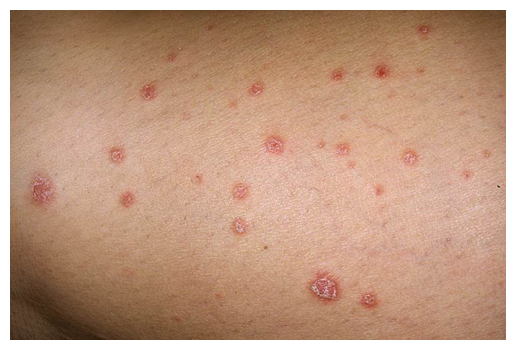

The predicted label for the uploaded image is: Guttate


In [37]:
# Function to preprocess the uploaded image
def preprocess_image(img_path):
    # Open the image file
    img = Image.open(img_path)
    
    # Enhance the image (if you want to use your enhancement function)
    enhanced_img = enhance_image_quality(img)
    
    # Resize the image to the input shape expected by the model (64x64)
    enhanced_img = enhanced_img.resize((64, 64))
    
    # Convert the image to an array
    img_array = image.img_to_array(enhanced_img)
    
    # Normalize the image (assuming your model expects this preprocessing)
    img_array = img_array / 255.0
    
    # Reshape it to include the batch dimension (1, 64, 64, 3)
    img_array = np.expand_dims(img_array, axis=0)
    
    return img_array

# Function to predict the class of the uploaded image
def predict_image_class(img_path):
    # Preprocess the image
    img_array = preprocess_image(img_path)
    
    # Predict the class using the CNN model
    prediction = cnn_model_es.predict(img_array)
    
    # Get the index of the class with the highest probability
    predicted_class_index = np.argmax(prediction)
    
    # Map the class index to the actual label
    predicted_class_label = label_encoder.classes_[predicted_class_index]
    
    # Display the image
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    
    # Return the prediction label
    return predicted_class_label

img_path = "D:\\1\\Guttate-psoriasis-pictures.jpg"
predicted_label = predict_image_class(img_path)
print(f"The predicted label for the uploaded image is: {predicted_label}")